## Setup 🪓

In [ ]:
# Check the GPU
!nvidia-smi

Sun Nov 10 08:07:33 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   41C    P8              12W /  72W |      1MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
# Install dependencies.
!pip install bitsandbytes transformers accelerate peft -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.4/122.4 MB 18.8 MB/s eta 0:00:00


Make sure to install `diffusers` from `main`.

In [ ]:
!pip install git+https://github.com/huggingface/diffusers.git -q

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


Download diffusers SDXL Lora training file.

In [ ]:
!wget https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora_sdxl.py

--2024-11-10 12:11:09--  https://raw.githubusercontent.com/huggingface/diffusers/main/examples/text_to_image/train_text_to_image_lora_sdxl.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 55573 (54K) [text/plain]
Saving to: ‘train_text_to_image_lora_sdxl.py’

train_text_to_image 100%[===================>]  54.27K  --.-KB/s    in 0.01s   

2024-11-10 12:11:09 (4.33 MB/s) - ‘train_text_to_image_lora_sdxl.py’ saved [55573/55573]



## Dataset 🐶

**Let's get our training data!**
For this example, we'll download some images from the hub

If you already have a dataset on the hub you wish to use, you can skip this part and go straight to: "Prep for
training 💻" section, where you'll simply specify the dataset name.

If your images are saved locally, and/or you want to add BLIP generated captions,
pick option 1 or 2 below.



**Option 1:** upload example images from your local files:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Preview the images:

In [ ]:
from PIL import Image

def image_grid(imgs, rows, cols, resize=256):

    if resize is not None:
        imgs = [img.resize((resize, resize)) for img in imgs]
    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

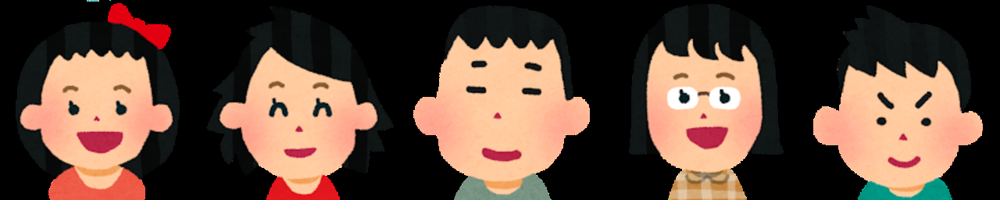

In [ ]:
import glob

# change path to display images from your local dir
img_paths = "./drive/MyDrive/irasutoya_face_dataset_512_512" #@param
imgs = [Image.open(path) for path in glob.glob(img_paths+"/*.png")]

num_imgs_to_preview = 5
image_grid(imgs[:num_imgs_to_preview], 1, num_imgs_to_preview)

### Generate custom captions with BLIP
Load BLIP to auto caption your images:

In [ ]:
import requests
from transformers import AutoProcessor, BlipForConditionalGeneration
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"

# load the processor and the captioning model
blip_processor = AutoProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base",torch_dtype=torch.float16).to(device)

# captioning utility
def caption_images(input_image):
    inputs = blip_processor(images=input_image, return_tensors="pt").to(device, torch.float16)
    pixel_values = inputs.pixel_values

    generated_ids = blip_model.generate(pixel_values=pixel_values, max_length=50)
    generated_caption = blip_processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
    return generated_caption

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

In [ ]:
import glob
from PIL import Image

# create a list of (Pil.Image, path) pairs
local_dir = "./drive/MyDrive/irasutoya_face_dataset_170_170/"
imgs_and_paths = [(path,Image.open(path)) for path in glob.glob(f"{local_dir}*.png")]

In [ ]:
import json

caption_prefix = "In the style of irasutoya " #@param
with open(f'{local_dir}metadata.jsonl', 'w') as outfile:
  for img in imgs_and_paths:
      caption = caption_prefix + caption_images(img[1]).split("\n")[0]
      entry = {"file_name":img[0].split("/")[-1], "prompt": caption}
      print("---")
      print(entry.items())
      print("----")
      json.dump(entry, outfile)
      outfile.write('\n')

---
dict_items([('file_name', 'boy_01.png'), ('prompt', 'In the style of irasutoya a boy with a green shirt and black hair')])
----
---
dict_items([('file_name', 'boy_02.png'), ('prompt', 'In the style of irasutoya a cartoon character with a surprised look')])
----
---
dict_items([('file_name', 'boy_03.png'), ('prompt', 'In the style of irasutoya a boy with a yellow shirt and brown hair')])
----
---
dict_items([('file_name', 'boy_04.png'), ('prompt', 'In the style of irasutoya a cartoon character with a green shirt and black hair')])
----
---
dict_items([('file_name', 'boy_05.png'), ('prompt', 'In the style of irasutoya a boy with a green shirt and brown hair')])
----
---
dict_items([('file_name', 'boy_06.png'), ('prompt', 'In the style of irasutoya a cartoon character with a green shirt and black hair')])
----
---
dict_items([('file_name', 'boy_07.png'), ('prompt', 'In the style of irasutoya a cartoon character with a blue shirt and a smile')])
----
---
dict_items([('file_name', 'boy_

Free some memory:

In [ ]:
import gc

# delete the BLIP pipelines and free up some memory
del blip_processor, blip_model
gc.collect()
torch.cuda.empty_cache()

< 추가 수정 >\
단계별로

- 캐릭터의 연령, 성별
- 캐릭터가 입고있는 옷, 옷의 세부 색깔, 안경 유무
- 캐릭터의 표정, 눈썹, 눈 모양, 입 모양
- 캐릭터의 머리 스타일 및 색깔, 머리띠 및 장식 유무

In [ ]:
# 수정 이후
with open(f'{local_dir}metadata.jsonl', 'r') as outfile:
  for caption in zip(imgs_and_paths, outfile.readlines()):
      print("---")
      print(caption[1])
      print("----")

---
{"file_name": "boy_01.png", "prompt": "In the style of irasutoya, 1boy, darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair"}

----
---
{"file_name": "boy_02.png", "prompt": "In the style of irasutoya, 1boy, skyblue shirt and glasses, mouth open in surprise, round eyes filled with astonishment, eyebrows raised, brown parted hair"}

----
---
{"file_name": "boy_03.png", "prompt": "In the style of irasutoya, 1boy, orange shirt, pouting with mouth puckered, eyes closed, eyebrows lowered, brown pouty hair"}

----
---
{"file_name": "boy_04.png", "prompt": "In the style of irasutoya, 1boy, darkcyan shirt, furrowing thick eyebrows, smiling widely with mouth closed, black hair styled upwards"}

----
---
{"file_name": "boy_05.png", "prompt": "In the style of irasutoya, 1boy, light green collared shirt, smiling with mouth closed, with a relaxed expression, brown bowl-cut hair"}

----
---
{"file_name": "boy_06.png", "prompt": "In the style of irasutoya, 1boy, dark s

In [ ]:
# Version2 수정 이후
with open(f'{local_dir}metadata.jsonl', 'r') as outfile:
  for caption in zip(imgs_and_paths, outfile.readlines()):
      print("---")
      print(caption[1])
      print("----")

## Prep for training 💻

Initialize `accelerate`:

In [ ]:
import locale
original_encoding = locale.getpreferredencoding
locale.getpreferredencoding = lambda: "UTF-8"

!accelerate config default

accelerate configuration saved at /root/.cache/huggingface/accelerate/default_config.yaml


### Log into your Hugging Face account
Pass [your **write** access token](https://huggingface.co/settings/tokens) so that we can push the trained checkpoints to the Hugging Face Hub:

In [ ]:
from huggingface_hub import notebook_login
notebook_login()

## Train! 🔬

#### Set Hyperparameters ⚡
To ensure we can DreamBooth with LoRA on a heavy pipeline like Stable Diffusion XL, we're using:

* Gradient checkpointing (`--gradient_accumulation_steps`)
* 8-bit Adam (`--use_8bit_adam`)
* Mixed-precision training (`--mixed-precision="fp16"`)

### Launch training 🚀🚀🚀

To allow for custom captions we need to install the `datasets` library, you can skip that if you want to train solely
 with `--instance_prompt`.
In that case, specify `--instance_data_dir` instead of `--dataset_name`

In [ ]:
!pip install datasets -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 480.6/480.6 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.3/179.3 kB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 12.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 17.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.


 - Use `--output_dir` to specify your LoRA model repository name!
 - Use `--caption_column` to specify name of the cpation column in your dataset. In this example we used "prompt" to
 save our captions in the
 metadata file, change this according to your needs.

In [ ]:
#!/usr/bin/env bash
#   --instance_prompt="in the style of irasutoya" \ if you didn't add prefix caption
#   --resume_from_checkpoint="./drive/MyDrive/base_LoRA_512_512/checkpoint-160"

In [ ]:
!accelerate launch train_text_to_image_lora_sdxl.py \
  --pretrained_model_name_or_path="OnomaAIResearch/Illustrious-xl-early-release-v0" \
  --dataset_name="./drive/MyDrive/irasutoya_face_dataset_170_170" \
  --output_dir="./drive/MyDrive/base_LoRA_170_170_to_1024_1024/" \
  --caption_column="prompt"\
  --mixed_precision="fp16" \
  --resolution=512 \
  --train_batch_size=1 \
  --gradient_accumulation_steps=6 \
  --gradient_checkpointing \
  --learning_rate=1e-4 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=0 \
  --mixed_precision="fp16" \
  --use_8bit_adam \
  --num_train_epochs=50 \
  --checkpointing_steps=10 \
  --checkpoints_total_limit=20 \
  --seed=42 \
  --rank=160 \
  --report_to="wandb"

2024-11-10 11:31:39.364116: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-10 11:31:39.382313: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-10 11:31:39.403557: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-10 11:31:39.410056: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-10 11:31:39.425677: I tensorflow/core/platform/cpu_feature_guar

### Save your model to the hub and check it out 🔥

In [ ]:
from huggingface_hub import whoami
from pathlib import Path
#@markdown make sure the `output_dir` you specify here is the same as the one used for training
output_dir = "base_LoRA_512_512_bs6_step200" #@param
checkpoint_dir = "./drive/MyDrive/base_LoRA_512_512/checkpoint-200" #@param
username = whoami(token=Path("/root/.cache/huggingface/"))["name"]
repo_id = f"{username}/{output_dir}"

In [ ]:
# @markdown Sometimes training finishes succesfuly (i.e. a **.safetensores** file with the LoRA weights saved properly to your local `output_dir`) but there's not enough RAM in the free tier to push the model to the hub 🙁
# @markdown
# @markdown To mitigate this, run this cell with your training arguments to make sure your model is uploaded! 🤗

# push to the hub🔥
from train_dreambooth_lora_sdxl import save_model_card
from huggingface_hub import upload_folder, create_repo

repo_id = create_repo(repo_id, exist_ok=True).repo_id

# change the params below according to your training arguments
save_model_card(
    repo_id = repo_id,
    use_dora=False,
    images=[],
    base_model="OnomaAIResearch/Illustrious-xl-early-release-v0",
    train_text_encoder=False,
    validation_prompt=None,
    repo_folder=checkpoint_dir# output_dir,
)
# instance_prompt
upload_folder(
    repo_id=repo_id,
    folder_path=checkpoint_dir,# output_dir,
    commit_message="End of training",
    ignore_patterns=["step_*", "epoch_*"],
)

random_states_0.pkl:   0%|          | 0.00/14.4k [00:00<?, ?B/s]

Upload 5 LFS files:   0%|          | 0/5 [00:00<?, ?it/s]

scaler.pt:   0%|          | 0.00/988 [00:00<?, ?B/s]

scheduler.bin:   0%|          | 0.00/1.00k [00:00<?, ?B/s]

optimizer.bin:   0%|          | 0.00/476M [00:00<?, ?B/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/929M [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/NLPBada/base_LoRA_512_512_bs6_step200/commit/524b424df36f335ac1c0558851f25b42ddfb115b', commit_message='End of training', commit_description='', oid='524b424df36f335ac1c0558851f25b42ddfb115b', pr_url=None, pr_revision=None, pr_num=None)

In [ ]:
from IPython.display import display, Markdown

link_to_model = f"https://huggingface.co/{repo_id}"
display(Markdown("### Your model has finished training.\nAccess it here: {}".format(link_to_model)))

### Your model has finished training.
Access it here: https://huggingface.co/NLPBada/base_LoRA_512_512_bs6_step200

Let's generate some images with it!

## Inference 🐕

In [ ]:
import torch
from diffusers import DiffusionPipeline, AutoencoderKL, EulerAncestralDiscreteScheduler
import matplotlib.pyplot as plt

# vae = AutoencoderKL.from_pretrained("OnomaAIResearch/Illustrious-xl-early-release-v0", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "OnomaAIResearch/Illustrious-xl-early-release-v0",
    # vae=vae,
    torch_dtype=torch.float16,
    # variant="fp16",
    use_safetensors=True
)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
lora_path = "/content/drive/MyDrive/base_LoRA_512_512/checkpoint-200"#@param
pipe.load_lora_weights(lora_path)

In [ ]:
_ = pipe.to("cuda")

### Base version

  0%|          | 0/80 [00:00<?, ?it/s]

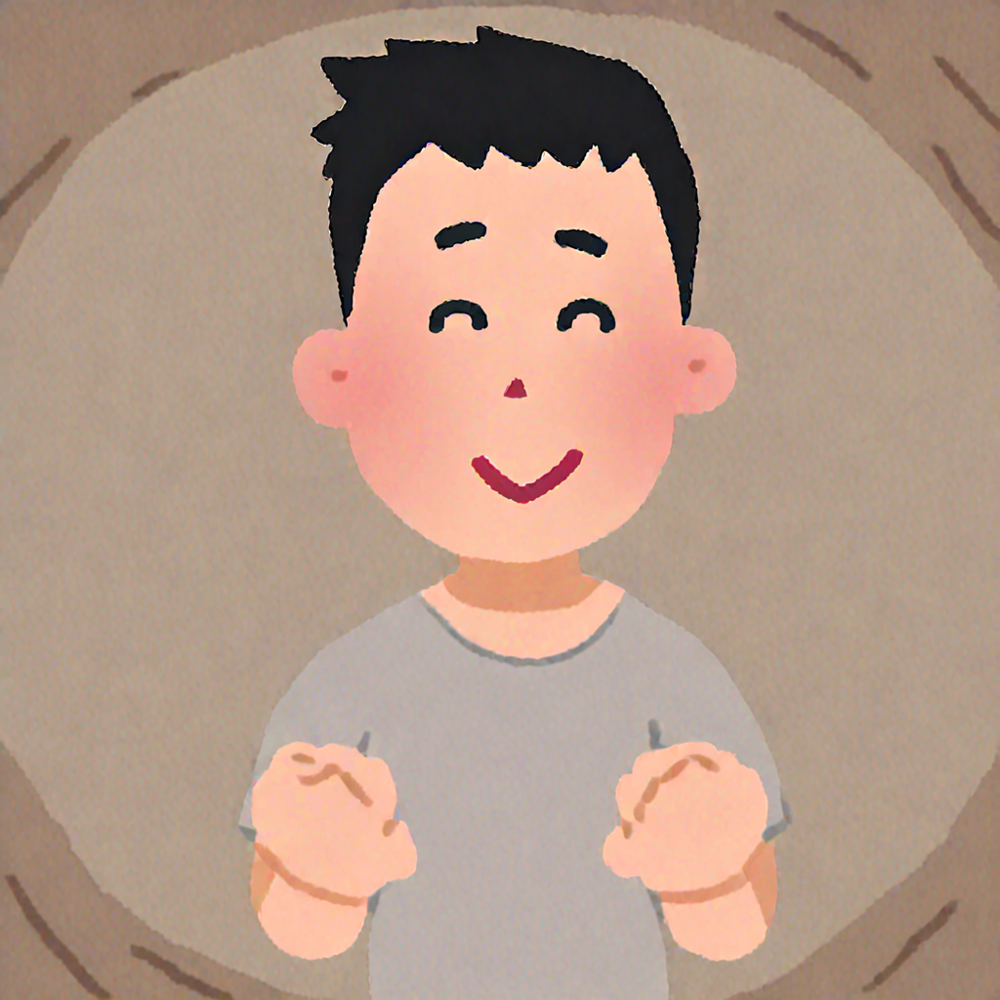

In [ ]:
#@markdown Base version
# guidance_scale = 6.5      # (5–7.5 recommanded) defaults to 7.5
prompt = "In the style of irasutoya a boy wearing a darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair, upper body" # @param
width = 1024 #@param
height = 1024 #@param
num_inference_steps = 80 #@param

image = pipe(prompt, num_inference_steps=num_inference_steps, width=width, height=height).images[0]
image

### Adjusted guidance_scale

  0%|          | 0/80 [00:00<?, ?it/s]

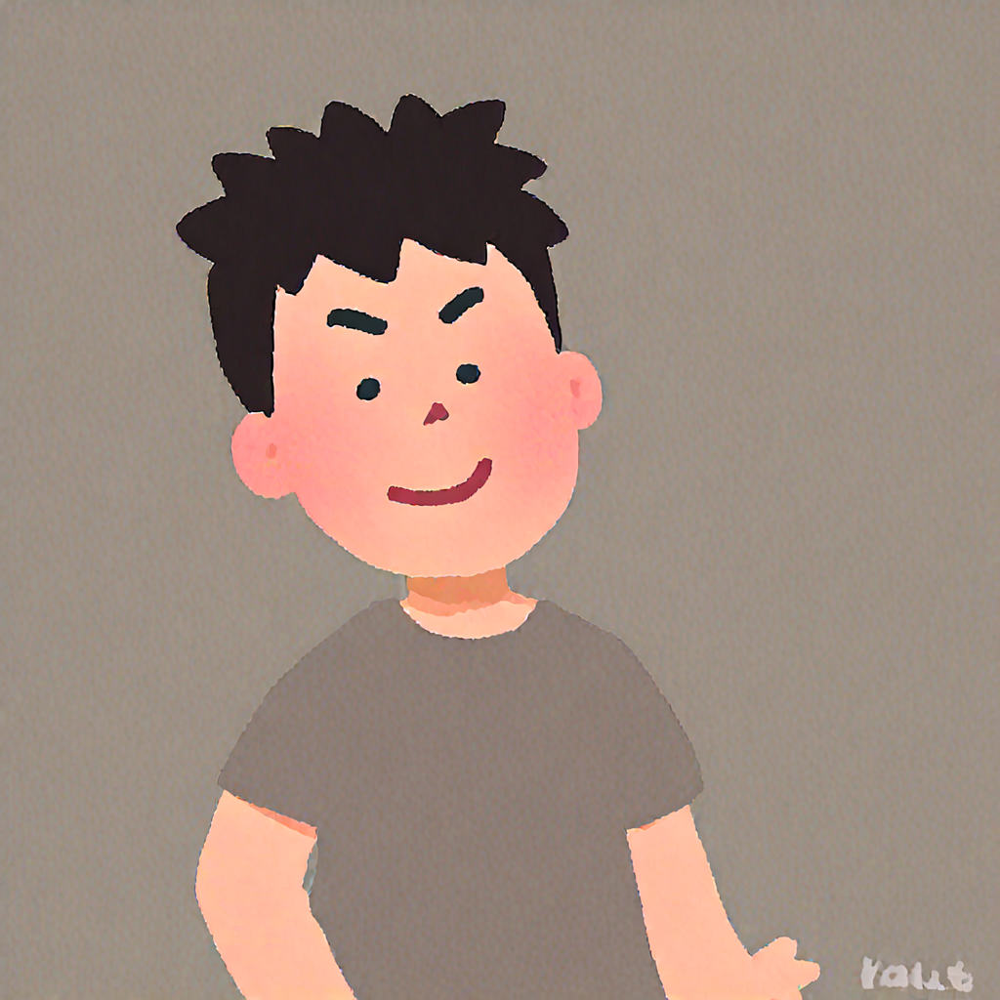

In [ ]:
#@markdown Adjusted guidance_scale
width = 1024 #@param
height = 1024 #@param
num_inference_steps = 80 #@param
guidance_scale = 6 #@param
# prompt = "In the style of irasutoya, 1girl, lightblue collared shirt, smiling with mouth closed, wearing glasses, eyes not visible, furrowed eyebrows, black bobbed parted hair" # @param
prompt = "In the style of irasutoya, 1boy wearing a darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair, upper body" # @param
negative_prompt = "worst quality, bad quality, low quality, scan artifacts, jaggy lines, unclear" #@param

image = pipe(prompt, num_inference_steps=num_inference_steps, target_size=(1024,1024), guidance_scale=guidance_scale).images[0]
image

### Adjusted guidance_scale + Negative Prompt

  0%|          | 0/60 [00:00<?, ?it/s]

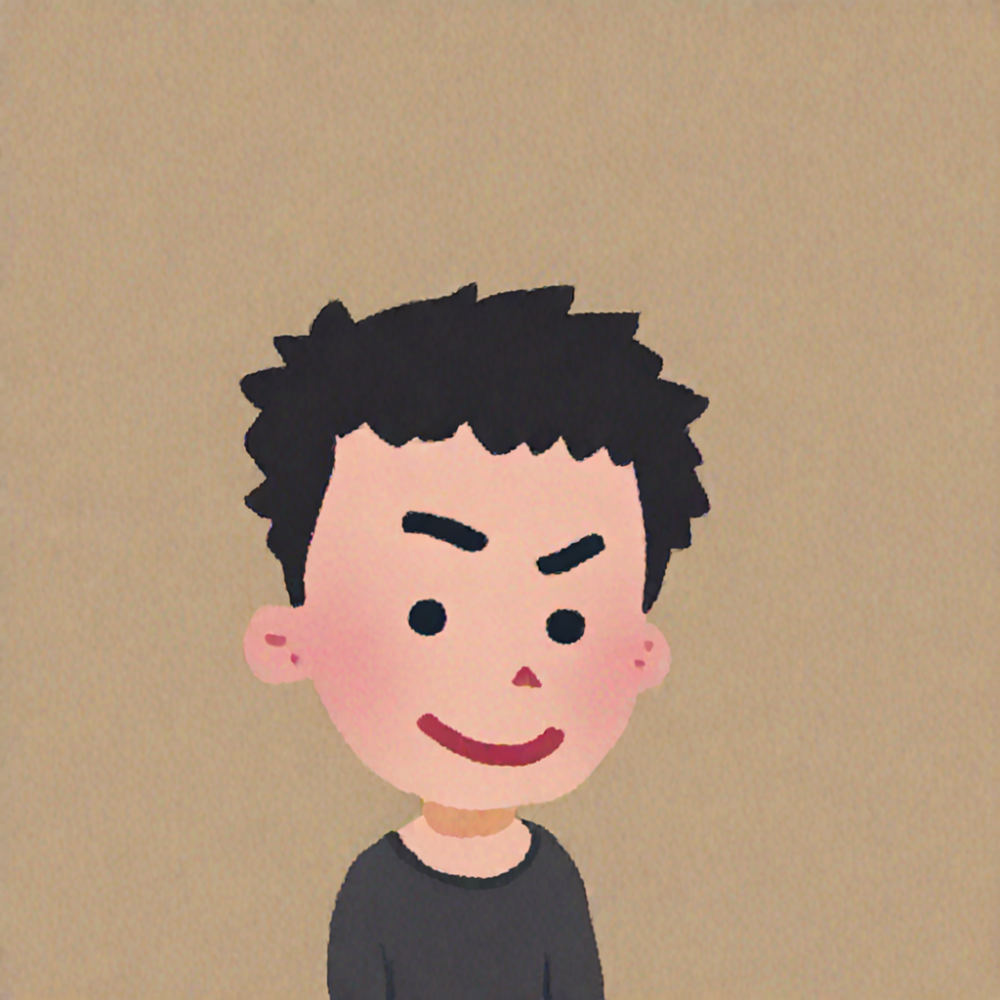

In [ ]:
#@markdown Adjusted guidance_scale + Negative Prompt
width = 1024 #@param
height = 1024 #@param
num_inference_steps = 60 #@param
guidance_scale = 5.5 #@param
# prompt = "In the style of irasutoya, 1girl, lightblue collared shirt, smiling with mouth closed, wearing glasses, eyes not visible, furrowed eyebrows, black bobbed parted hair" # @param
prompt = "In the style of irasutoya a boy wearing a darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair, upper body" # @param
negative_prompt = "duplicates, worst quality, bad quality, low quality, scan artifacts, jaggy lines, unclear" #@param

image = pipe(prompt, num_inference_steps=num_inference_steps, width=width, height=height, guidance_scale=guidance_scale).images[0]
image

### guidance - checkpoint relation

In [ ]:
from tqdm import tqdm
import torch
import matplotlib.pyplot as plt
import numpy as np

width = 1024 #@param
height = 1024 #@param
num_inference_steps = 80 #@param
checkpoint_dir = "/content/drive/MyDrive/base_LoRA_170_170" #@param

# Initialize the pipeline
pipe = DiffusionPipeline.from_pretrained(
    "OnomaAIResearch/Illustrious-xl-early-release-v0",
    torch_dtype=torch.float16,
    use_safetensors=True
)

# The prompt
prompt = "In the style of irasutoya a boy wearing a darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair" # @param

# Initialize an empty dictionary to store images based on guidance scale and checkpoint
images_dict = {}

# Set the guidance scales and checkpoints
guidance_scales = np.arange(5.0, 7.75, 0.25)
checkpoints = range(10, 210, 10)

# Iterate over checkpoints and guidance scales
for checkpoint in tqdm(checkpoints):
    images_dict[checkpoint] = []
        # Load the LoRA weights
    checkpoint_path = f"{checkpoint_dir}/checkpoint-{checkpoint}"
    pipe.load_lora_weights(checkpoint_path)
    # Move the pipeline to CUDA
    _ = pipe.to("cuda")

    for guidance_scale in guidance_scales:

        # Generate the image
        image = pipe(prompt, num_inference_steps=num_inference_steps, width=width, height=height, guidance_scale=guidance_scale).images[0]

        # Store the generated image
        images_dict[checkpoint].append(image)

100%|██████████| 20/20 [00:29<00:00,  1.47s/it]


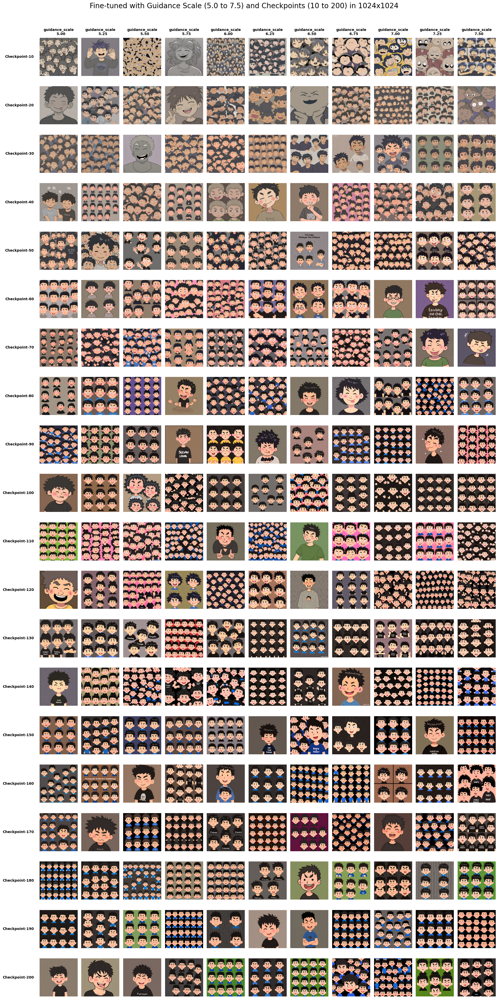

In [ ]:
# Create a grid of images
fig, axes = plt.subplots(len(checkpoints), len(guidance_scales), figsize=(20, 40), sharex=True, sharey=True)

# Plot the images in the grid
for row, checkpoint in tqdm(enumerate(checkpoints), total=len(checkpoints)):
    for col, guidance_scale in enumerate(guidance_scales):
        ax = axes[row, col]
        ax.imshow(images_dict[checkpoint][col])
        ax.axis('off')

        if row == 0:
            ax.annotate(f"guidance_scale\n    {guidance_scale:.2f}", xy=(0.5, 1.05), xycoords='axes fraction',
                        ha='center', va='bottom', fontsize=10, fontweight='bold')
        if col == 0:
            ax.annotate(f"Checkpoint-{checkpoint}", xy=(-0.15, 0.5), xycoords='axes fraction',
                        ha='right', va='center', fontsize=10, fontweight='bold')

# Display the grid
plt.suptitle('Fine-tuned with Guidance Scale (5.0 to 7.5) and Checkpoints (10 to 200) in 1024x1024', fontsize=20)
plt.tight_layout()
plt.subplots_adjust(top=0.95, left=0.1)  # Adjust margins for clarity
plt.show()

## Negative prompt

In [ ]:
import glob
from PIL import Image

# create a list of (Pil.Image, path) pairs
local_dir = "./drive/MyDrive/irasutoya_face_dataset_170_170/"
imgs_and_paths = [(path,Image.open(path)) for path in glob.glob(f"{local_dir}*.png")]

In [ ]:
prompts = []
with open(f'{local_dir}metadata.jsonl', 'r') as outfile:
  for caption in zip(imgs_and_paths, outfile.readlines()):
      print("---")
      print(eval(caption[1])['prompt'])
      print("----")
      prompts.append(eval(caption[1])['prompt'])

---
In the style of irasutoya, 1boy, darkcyan shirt, smiling with mouth closed, furrowing eyebrows, black pouty hair
----
---
In the style of irasutoya, 1boy, skyblue shirt and glasses, mouth open in surprise, round eyes filled with astonishment, eyebrows raised, brown parted hair
----
---
In the style of irasutoya, 1boy, orange shirt, pouting with mouth puckered, eyes closed, eyebrows lowered, brown pouty hair
----
---
In the style of irasutoya, 1boy, darkcyan shirt, furrowing thick eyebrows, smiling widely with mouth closed, black hair styled upwards
----
---
In the style of irasutoya, 1boy, light green collared shirt, smiling with mouth closed, with a relaxed expression, brown bowl-cut hair
----
---
In the style of irasutoya, 1boy, dark seagreen shirt, with a sleepy expression, straight eyebrows, eyes closed with a straight shape, smiling with mouth slightly open, black short hair
----
---
In the style of irasutoya, 1boy, skyblue shirt, laughing with mouth wide open, smiling eyebrow

In [ ]:
from tqdm import tqdm
import torch
import matplotlib.pyplot as plt
import numpy as np

width = 832 #@param
height = 1216 #@param
num_inference_steps = 80 #@param
checkpoint_path = "/content/drive/MyDrive/base_LoRA_512_512/checkpoint-200" #@param
negative_prompt = "duplicates, worst quality, bad quality, low quality, scan artifacts, jaggy lines, unclear"#@param

# Initialize the pipeline
pipe = DiffusionPipeline.from_pretrained(
    "OnomaAIResearch/Illustrious-xl-early-release-v0",
    torch_dtype=torch.float16,
    use_safetensors=True
)

# Initialize an empty dictionary to store images based on guidance scale and prompt
images_dict = {}

# Set the guidance scales
guidance_scales = np.arange(5.0, 5.75, 0.25)

# Load the LoRA weights
pipe.load_lora_weights(checkpoint_path)
# Move the pipeline to CUDA
_ = pipe.to("cuda")

# Iterate over checkpoints and guidance scales
for prompt in tqdm(prompts):
    images_dict[prompt] = []

    for guidance_scale in guidance_scales:

        # Generate the image
        image = pipe(prompt+" ,full body", negative_prompt=negative_prompt, num_inference_steps=num_inference_steps, width=width, height=height, guidance_scale=guidance_scale).images[0]

        # Store the generated image
        images_dict[prompt].append(image)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  4%|▍         | 1/24 [00:47<18:14, 47.59s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  8%|▊         | 2/24 [01:34<17:23, 47.44s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 12%|█▎        | 3/24 [02:22<16:34, 47.34s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 17%|█▋        | 4/24 [03:09<15:47, 47.39s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 21%|██        | 5/24 [03:56<14:59, 47.36s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 25%|██▌       | 6/24 [04:44<14:12, 47.37s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 29%|██▉       | 7/24 [05:31<13:24, 47.35s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 33%|███▎      | 8/24 [06:19<12:37, 47.36s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 38%|███▊      | 9/24 [07:06<11:50, 47.38s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 42%|████▏     | 10/24 [07:53<11:03, 47.39s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 46%|████▌     | 11/24 [08:41<10:15, 47.36s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 50%|█████     | 12/24 [09:28<09:28, 47.34s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 54%|█████▍    | 13/24 [10:15<08:41, 47.37s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 58%|█████▊    | 14/24 [11:03<07:53, 47.32s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 62%|██████▎   | 15/24 [11:50<07:06, 47.41s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 67%|██████▋   | 16/24 [12:38<06:20, 47.54s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 71%|███████   | 17/24 [13:25<05:32, 47.50s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 75%|███████▌  | 18/24 [14:13<04:44, 47.49s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 79%|███████▉  | 19/24 [15:00<03:57, 47.50s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 83%|████████▎ | 20/24 [15:48<03:10, 47.52s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 88%|████████▊ | 21/24 [16:36<02:22, 47.55s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 92%|█████████▏| 22/24 [17:23<01:35, 47.59s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

 96%|█████████▌| 23/24 [18:11<00:47, 47.54s/it]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

100%|██████████| 24/24 [18:58<00:00, 47.44s/it]


100%|██████████| 24/24 [00:01<00:00, 15.04it/s]


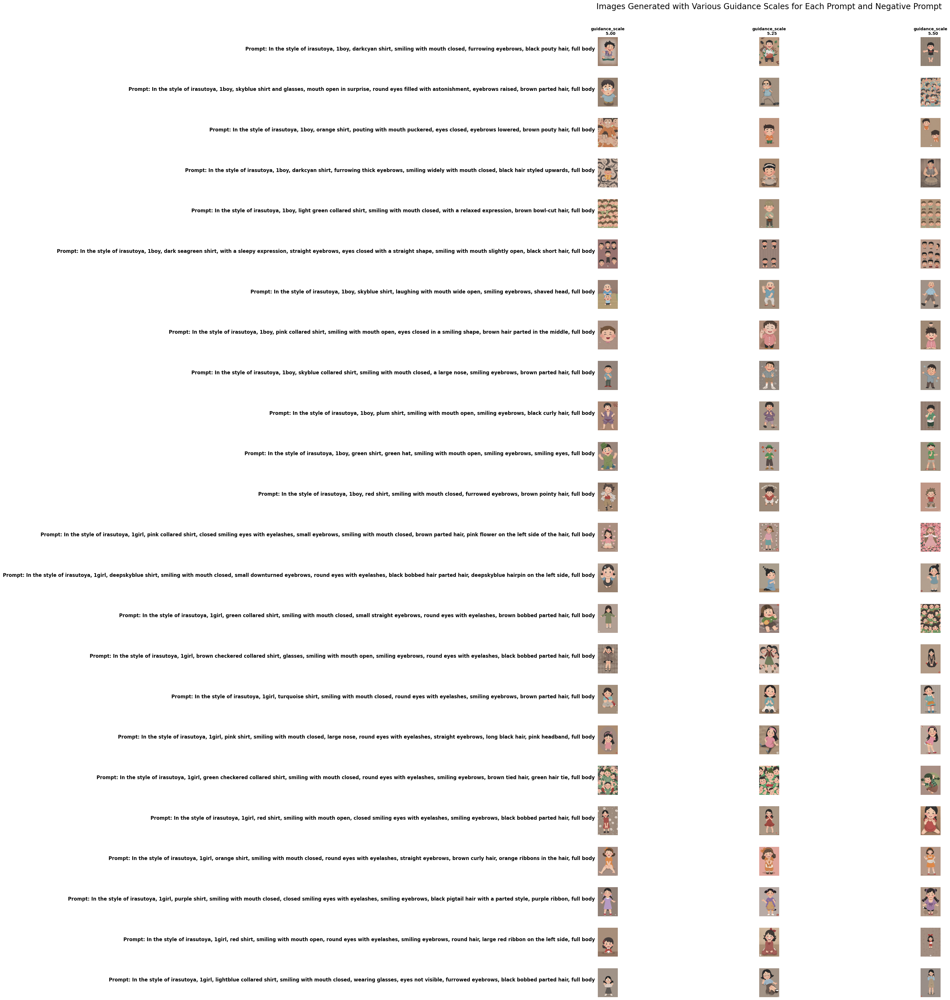

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

# Create a grid of images
fig, axes = plt.subplots(len(prompts), len(guidance_scales), figsize=(20, 40), sharex=True, sharey=True)

# Plot the images in the grid
for row, prompt in tqdm(enumerate(prompts), total=len(prompts)):
    for col, guidance_scale in enumerate(guidance_scales):
        ax = axes[row, col]
        ax.imshow(images_dict[prompt][col])
        ax.axis('off')

        # Annotate guidance scale on the top row
        if row == 0:
            ax.annotate(f"guidance_scale\n    {guidance_scale:.2f}", xy=(0.5, 1.05), xycoords='axes fraction',
                        ha='center', va='bottom', fontsize=10, fontweight='bold')

    # Annotate prompt on the bottom of each row
    axes[row, 0].annotate(f"Prompt: {prompt}, full body", xy=(-0.15, 0.5), xycoords='axes fraction',
                          ha='right', va='bottom', fontsize=12, fontweight='bold')

# Display the grid
plt.suptitle('Images Generated with Various Guidance Scales for Each Prompt and Negative Prompt', fontsize=20)
plt.subplots_adjust(top=0.95, left=0.1, hspace=0.4)  # Adjust margins and row spacing for clarity
plt.show()

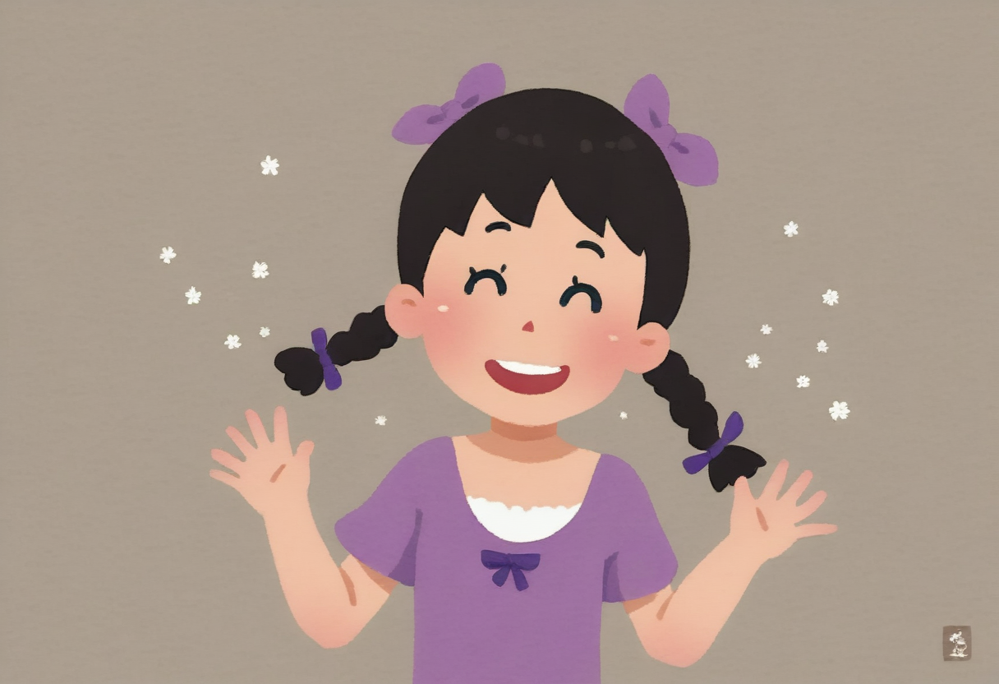

In [ ]:
images_dict["In the style of irasutoya, 1girl, purple shirt, smiling with mouth closed, closed smiling eyes with eyelashes, smiling eyebrows, black pigtail hair with a parted style, purple ribbon"][0]

### Saving

In [ ]:
import pickle
with open('./drive/MyDrive/Images_irasutoya/1024_1024_num_inference_80_negative_prompt.pickle','wb') as fw:
    pickle.dump(images_dict, fw)

In [ ]:
import pickle
with open('./drive/MyDrive/Images_irasutoya/1216_832_num_inference_80_negative_prompt.pickle','wb') as fw:
    pickle.dump(images_dict, fw)

In [ ]:
import pickle
with open('./drive/MyDrive/Images_irasutoya/832_1216_num_inference_80_negative_prompt.pickle','wb') as fw:
    pickle.dump(images_dict, fw)